<a href="https://colab.research.google.com/github/sungulnara2000/CIS_admission_task/blob/master/DocumentDistortion_Current.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Установка библиотек

In [1]:
!pip install opencv-contrib-python==3.4.2.17
!pip install -U plotly==4.12
!pip install pyheif Pillow
!pip install pdf2image
!apt-get install poppler-utils 
!pip install alphashape

     |████████████████████████████████| 30.6 MB 1.4 MB/s 
  Attempting uninstall: opencv-contrib-python
    Found existing installation: opencv-contrib-python 4.1.2.30
    Uninstalling opencv-contrib-python-4.1.2.30:
      Successfully uninstalled opencv-contrib-python-4.1.2.30
     |████████████████████████████████| 13.1 MB 30.3 MB/s 
  Created wheel for retrying: filename=retrying-1.3.3-py3-none-any.whl size=11447 sha256=0c0409e422bc04ab626366a650c5b9807cd57d84defa690e5502cbe15a9667e0
  Stored in directory: /root/.cache/pip/wheels/f9/8d/8d/f6af3f7f9eea3553bc2fe6d53e4b287dad18b06a861ac56ddf
Successfully built retrying
  Attempting uninstall: plotly
    Found existing installation: plotly 5.5.0
    Uninstalling plotly-5.5.0:
      Successfully uninstalled plotly-5.5.0
     |████████████████████████████████| 9.8 MB 21.7 MB/s 
Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following NEW packages will be installed:
  poppler-utils
0 upg

In [2]:
def sin(angle):
  return np.sin(np.deg2rad(angle))

def cos(angle):
  return np.cos(np.deg2rad(angle))

def rint(x):
  ret = np.rint(x).astype(int)
  if type(x) == tuple:
    ret = tuple(ret)
  return ret

def int_tuple(l):
  return tuple(map(int, l))

def nearest_odd(x):
    return int(np.ceil(x) // 2 * 2 + 1)

def reduce_in_size(image, n):
  return cv.resize(image, (rint(image.shape[1] / n), rint(image.shape[0] / n)))

In [3]:
import os
from os import path
import glob
import pyheif


import numpy as np
from tqdm import tqdm
import itertools
import random

import cv2 as cv
from google.colab.patches import cv2_imshow
from PIL import Image

# from scipy.spatial import distance
# from scipy.optimize import brentq


from scipy import interpolate

import pdf2image

import alphashape
from descartes import PolygonPatch

import plotly.graph_objects as go
import plotly.express as px
import matplotlib.pyplot as plt
from IPython.display import clear_output

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
def conv_heic2png(image_path, delete=False):
    new_name = image_path.replace('HEIC', 'png')
    heif_file = pyheif.read(image_path)
    data = Image.frombytes(
        heif_file.mode,
        heif_file.size,
        heif_file.data,
        "raw",
        heif_file.mode,
        heif_file.stride,
        )
    data.save(new_name, "PNG")
    if delete:
      os.remove(image_path)

def heic2png(path, delete=False):
  lst = glob.glob(f"{path}/*.HEIC")
  for l in lst:
      conv_heic2png(l, delete)

In [6]:
SAMPLES_FOLDER = '/content/drive/MyDrive/paper_distortions'
RESULTS_FOLDER = os.path.join(SAMPLES_FOLDER, 'results')
CRUMPLED_RESULTS_FOLDER = os.path.join(SAMPLES_FOLDER, 'crumpled_results')
EDOCS_FOLDER = os.path.join(SAMPLES_FOLDER, 'electronic_documents')
EDOCS_PDF_FOLDER = os.path.join(SAMPLES_FOLDER, 'pdfs')
BACKGROUND_FOLDER = os.path.join(SAMPLES_FOLDER, 'background')

PDF_DPI = 400

N_COLS = 21
N_ROWS = 30

In [7]:
# heic2png(SAMPLES_FOLDER, delete=True)
# heic2png(BACKGROUND_FOLDER, delete=True)

In [8]:
# !rm $EDOCS_FOLDER/*

In [9]:
# pdfs = os.listdir(EDOCS_PDF_FOLDER)
# for filename in pdfs:
#   basename = filename.split('.')[0]
  
#   kwargs = {}
#   if 'british-airways' in basename:
#     kwargs['first_page'] = 5
#     kwargs['last_page'] = 13

#   pdf2image.convert_from_path(os.path.join(EDOCS_PDF_FOLDER, filename), 
#                               dpi=PDF_DPI, 
#                               output_folder=EDOCS_FOLDER,
#                               fmt='png',
#                               output_file=f'{basename}_dpi_{PDF_DPI}',
#                               **kwargs)

# Детекция точек

In [7]:
CIRCLE_N = 32
reference_circle = np.ones((CIRCLE_N, CIRCLE_N), np.uint8) * 255
reference_circle = cv.circle(reference_circle, 
                             rint((CIRCLE_N/2, CIRCLE_N/2)), 
                             rint(CIRCLE_N/5), 
                             color=(0, 0, 0), 
                             thickness=-1)

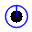

In [8]:
surf = cv.xfeatures2d.SURF_create(hessianThreshold=700, nOctaves=2, nOctaveLayers=2, upright=True)
reference_circle_kp, reference_circle_des = surf.detectAndCompute(reference_circle, None)
img_surf = cv.drawKeypoints(reference_circle, reference_circle_kp, None,(255,0,0),4)
cv2_imshow(img_surf)

In [9]:
def intersection_area(d, R, r):
    """Return the area of intersection of two circles.

    The circles have radii R and r, and their centres are separated by d.

    """

    if d <= abs(R-r):
        # One circle is entirely enclosed in the other.
        return np.pi * min(R, r)**2
    if d >= r + R:
        # The circles don't overlap at all.
        return 0

    r2, R2, d2 = r**2, R**2, d**2
    alpha = np.arccos((d2 + r2 - R2) / (2*d*r))
    beta = np.arccos((d2 + R2 - r2) / (2*d*R))
    return ( r2 * alpha + R2 * beta -
             0.5 * (r2 * np.sin(2*alpha) + R2 * np.sin(2*beta))
           )

In [10]:
def iou_key_points(kp_one, kp_two):
  distance_between_centers = np.linalg.norm(np.array(kp_one.pt) - np.array(kp_two.pt))
  intersection = intersection_area(distance_between_centers, kp_one.size, kp_two.size)
  area_one = np.pi * kp_one.size ** 2
  area_two = np.pi * kp_two.size ** 2
  return intersection / (area_one + area_two - intersection)

def delete_similar_key_points(kp, iou_threshold):
  """
  Note that kp should be passed in descending response order (as from detectAndCompute)
  """
  assert sorted(kp, key=lambda x: -x.response) == kp

  new_kp = []
  indices = []

  for i, point in enumerate(kp):
    discard = False
    for compare_point in kp:
      if iou_key_points(point, compare_point) >= iou_threshold:
        if compare_point.response > point.response:
          discard = True
    if not discard:
      new_kp.append(point)
      indices.append(i)

  return new_kp, indices

## Запуск

In [ ]:
img = cv.imread(path.join(SAMPLES_FOLDER, 'IMG_1436.png'))
img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

surf = cv.xfeatures2d.SURF_create(hessianThreshold=1500, upright=True)

img_blur = cv.GaussianBlur(img, (15, 15), 0)

# cv2_imshow(img_blur)
kp, des = surf.detectAndCompute(img_blur, None)

print(kp[0].pt)

img_surf = cv.drawKeypoints(img, kp, None,(255,0,0), 4)
# cv2_imshow(cv.resize(img_surf, (rint(img_surf.shape[1] / 2), rint(img_surf.shape[0] / 2))))

(2189.21533203125, 2634.302978515625)


In [ ]:
new_kp, indices = delete_similar_key_points(kp, iou_threshold=0.2)

In [ ]:
len(kp), len(new_kp)

(1412, 692)

In [ ]:
new_des = des[indices]

In [ ]:
img_surf = cv.drawKeypoints(img, new_kp, None,(255,0,0), 4)
cv2_imshow(cv.resize(img_surf, (rint(img_surf.shape[1] / 2), rint(img_surf.shape[0] / 2))))

In [ ]:
circle_kp = sorted(list(zip(new_kp, new_des)), key=lambda x: np.linalg.norm(x[1] - reference_circle_des))
circle_kp = [x[0] for x in circle_kp]

In [ ]:
img_surf = cv.drawKeypoints(img, circle_kp[:N_COLS * N_ROWS], None, (255, 0, 0), 4)
cv2_imshow(cv.resize(img_surf, (rint(img_surf.shape[1] / 2), rint(img_surf.shape[0] / 2))))

In [ ]:
img = cv.imread(path.join(SAMPLES_FOLDER, 'IMG_1443.png'))

# convert img to grayscale
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

# blur image
blur = cv.GaussianBlur(gray, (9,9), 0)

# do otsu threshold on gray image
thresh = cv.adaptiveThreshold(blur, 255, cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY, 77, 33)
# thresh = cv.threshold(blur, 0, 255, cv.THRESH_BINARY+cv.THRESH_OTSU)[1]

# apply morphology
kernel = np.ones((7,7), np.uint8)
morph = cv.morphologyEx(thresh, cv.MORPH_CLOSE, kernel)
# kernel = np.ones((9,9), np.uint8)
morph = cv.morphologyEx(morph, cv.MORPH_OPEN, kernel)

# cv2_imshow(blur)
cv2_imshow(thresh)
cv2_imshow(morph)

# get largest contour
contours = cv.findContours(morph, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
contours = contours[0] if len(contours) == 2 else contours[1]
big_contour = max(contours, key = cv.contourArea)

countour_img = cv.drawContours(img, [big_contour], 0, (0,255,0), 3)
# cv2_imshow(countour_img)

In [ ]:
img = cv.imread(path.join(SAMPLES_FOLDER, 'IMG_1435.png'))

# convert img to grayscale
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

# blur image
blur = cv.GaussianBlur(gray, (9,9), 0)

# do otsu threshold on gray image
thresh = cv.adaptiveThreshold(blur, 255, cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY, 77, 33)
# thresh = cv.threshold(blur, 0, 255, cv.THRESH_BINARY+cv.THRESH_OTSU)[1]

# apply morphology
kernel = np.ones((7,7), np.uint8)
morph = cv.morphologyEx(thresh, cv.MORPH_CLOSE, kernel)
morph = cv.morphologyEx(morph, cv.MORPH_OPEN, kernel)

# cv2_imshow(blur)
cv2_imshow(thresh)
cv2_imshow(morph)

# get largest contour
contours = cv.findContours(morph, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
contours = contours[0] if len(contours) == 2 else contours[1]
big_contour = max(contours, key = cv.contourArea)

countour_img = cv.drawContours(img, [big_contour], 0, (0,255,0), 3)
# cv2_imshow(countour_img)

In [ ]:
img = cv.imread(path.join(SAMPLES_FOLDER, 'IMG_1435.png'))

# convert img to grayscale
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

# blur image
blur = cv.GaussianBlur(gray, (9,9), 0)

# do otsu threshold on gray image
thresh = cv.adaptiveThreshold(blur,255, cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY, nearest_odd(blur.shape[0] / 100), 5)
# thresh = cv.threshold(blur, 0, 255, cv.THRESH_BINARY+cv.THRESH_OTSU)[1]

# apply morphology
kernel = np.ones((7,7), np.uint8)
morph = cv.morphologyEx(thresh, cv.MORPH_CLOSE, kernel)
morph = cv.morphologyEx(morph, cv.MORPH_OPEN, kernel)

# cv2_imshow(blur)
cv2_imshow(thresh)
cv2_imshow(morph)

# get largest contour
contours = cv.findContours(morph, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
contours = contours[0] if len(contours) == 2 else contours[1]
big_contour = max(contours, key = cv.contourArea)

countour_img = cv.drawContours(img, [big_contour], 0, (0,255,0), 3)
# cv2_imshow(countour_img)

In [ ]:
nearest_odd(blur.shape[0] / 200)

21

In [ ]:
img = cv.imread(path.join(SAMPLES_FOLDER, 'IMG_1435.png'))

# convert img to grayscale
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

# blur image
blur = cv.GaussianBlur(gray, (11,11), 0)

# do otsu threshold on gray image
thresh = cv.adaptiveThreshold(blur,255, cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY, 41, 5)

# apply morphology
kernel = np.ones((7,7), np.uint8)
morph = cv.morphologyEx(thresh, cv.MORPH_CLOSE, kernel)
kernel = np.ones((7, 7), np.uint8)
morph = cv.morphologyEx(morph, cv.MORPH_OPEN, kernel)

cv2_imshow(blur)
cv2_imshow(thresh)
cv2_imshow(morph)

# get largest contour
contours = cv.findContours(morph, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
contours = contours[0] if len(contours) == 2 else contours[1]
big_contour = max(contours, key = cv.contourArea)

countour_img = cv.drawContours(img, [big_contour], 0, (0,255,0), 3)
# cv2_imshow(countour_img)

In [ ]:
cv.pointPolygonTest(big_contour, (2000, 2000), measureDist=False), cv.pointPolygonTest(big_contour, (2000, 2000), measureDist=True)

(1.0, 550.9863882166237)

In [ ]:
cv.pointPolygonTest(big_contour, (0, 0), measureDist=False), cv.pointPolygonTest(big_contour, (0, 0), measureDist=True)

(-1.0, -477.3782567314938)

In [ ]:
!ls $SAMPLES_FOLDER

6a2e56bf-11e1-4cd0-aef1-3d628d49c458-2.jpg  IMG_1446.png
alined.jpg				    IMG_1447.png
electronic_documents			    IMG_1449.png
IMG_1435.png				    IMG-20211130-WA0067-2.jpg
IMG_1436.png				    IMG-20211130-WA0067.jpg
IMG_1438.png				    IMG-20211130-WA0069-2.jpg
IMG_1439.png				    IMG-20211130-WA0069.jpg
IMG_1441.png				    photo_2021-12-26_19-00-26.jpg
IMG_1442.png				    qXYn5.jpg
IMG_1443.png				    red_blue_dots_a4_2480_3508.png
IMG_1445.png


In [ ]:
surf = cv.xfeatures2d.SIFT_create(hessianThreshold=700, nOctaves=2, nOctaveLayers=2, upright=True)

img_blur = cv.GaussianBlur(img, (15, 15), 0)
cv2_imshow(img_blur)
kp, des = surf.detectAndCompute(img_blur, None)

# Удаление маркеров

In [ ]:
img = cv.imread(path.join(SAMPLES_FOLDER, 'IMG_1436.png'))

# convert img to grayscale
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

# blur image
blur = cv.GaussianBlur(gray, (9,9), 0)

# do otsu threshold on gray image
thresh = cv.adaptiveThreshold(blur, 255, cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY, 77, 33)
# thresh = cv.threshold(blur, 0, 255, cv.THRESH_BINARY+cv.THRESH_OTSU)[1]

# apply morphology
kernel = np.ones((7,7), np.uint8)
morph = cv.morphologyEx(thresh, cv.MORPH_CLOSE, kernel)
morph = cv.morphologyEx(morph, cv.MORPH_OPEN, kernel)

cv2_imshow(morph)

In [ ]:
countour_img = cv.drawContours(img, contours, -1, (0,255,0), 3)
cv2_imshow(countour_img)

In [ ]:
cv2_imshow(morph)

In [ ]:
contours = cv.findContours(morph, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)

In [ ]:
len(contours[1])

1

In [ ]:
big_contour = max(contours[1], key = cv.contourArea)

In [ ]:
img = cv.imread(path.join(SAMPLES_FOLDER, 'IMG_1442.png'))
contour_image = cv.drawContours(img, [big_contour], 0, (0,255,0), 3)
cv2_imshow(cv.resize(contour_image, (1512, 2016)))

In [ ]:
cv2_imshow(cv.drawContours(img, contours[1], -1, (0,255,0), 3))

In [ ]:
img = cv.imread(path.join(SAMPLES_FOLDER, 'IMG_1442.png'))


# convert img to grayscale
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

# blur image
blur = cv.GaussianBlur(gray, (9,9), 0)

# do otsu threshold on gray image
# thresh = cv.adaptiveThreshold(blur,255,cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY, nearest_odd(blur.shape[0] / 100), 5)
thresh = cv.threshold(blur, 0, 255, cv.THRESH_BINARY+cv.THRESH_OTSU)[1]

# apply morphology
kernel = np.ones((7,7), np.uint8)
thresh = thresh
morph = cv.morphologyEx(thresh, cv.MORPH_CLOSE, kernel)
morph = cv.morphologyEx(morph, cv.MORPH_OPEN, kernel)
# kernel = np.ones((3,3), np.uint8)
# morph = cv.erode(morph, kernel, iterations=1)

# cv2_imshow(blur)
# cv2_imshow(thresh)
# cv2_imshow(morph)

# get largest contour
contours = cv.findContours(morph, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
contours = contours[0] if len(contours) == 2 else contours[1]
big_contour = max(contours, key = cv.contourArea)

countour_img = cv.drawContours(img, [big_contour], 0, (0,255,0), 3)
# cv2_imshow(countour_img)

In [ ]:
img = cv.imread(path.join(SAMPLES_FOLDER, 'IMG_1442.png'))


# convert img to grayscale
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

# blur image
blur = cv.GaussianBlur(gray, (9,9), 0)

# do otsu threshold on gray image
thresh = cv.adaptiveThreshold(blur,255,cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY, nearest_odd(blur.shape[0] / 100), 5)

# apply morphology
kernel = np.ones((7,7), np.uint8)
morph = cv.morphologyEx(thresh, cv.MORPH_CLOSE, kernel)
morph = cv.morphologyEx(morph, cv.MORPH_OPEN, kernel)

# cv2_imshow(blur)
# cv2_imshow(thresh)
# cv2_imshow(morph)

# get largest contour
contours = cv.findContours(morph, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
contours = contours[0] if len(contours) == 2 else contours[1]
big_contour = max(contours, key = cv.contourArea)

countour_img = cv.drawContours(img, [big_contour], 0, (0,255,0), 3)
cv2_imshow(countour_img)

In [ ]:
img = cv.imread(path.join(SAMPLES_FOLDER, 'IMG_1436.png'))


# convert img to grayscale
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

# blur image
blur = cv.GaussianBlur(gray, (9,9), 0)

# do otsu threshold on gray image
thresh = cv.adaptiveThreshold(blur,255,cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY, nearest_odd(blur.shape[0] / 100), 5)

# apply morphology
kernel = np.ones((7,7), np.uint8)
morph = cv.morphologyEx(thresh, cv.MORPH_CLOSE, kernel)
morph = cv.morphologyEx(morph, cv.MORPH_OPEN, kernel)

# cv2_imshow(blur)
# cv2_imshow(thresh)
cv2_imshow(morph)

# get largest contour
contours = cv.findContours(morph, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
contours = contours[0] if len(contours) == 2 else contours[1]
big_contour = max(contours, key = cv.contourArea)

countour_img = cv.drawContours(img, [big_contour], 0, (0,255,0), 3)
cv2_imshow(countour_img)

In [ ]:
# do otsu threshold on gray image
thresh = cv.adaptiveThreshold(blur, 255, cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY, nearest_odd(blur.shape[0] / 100), 5)

# apply morphology
kernel = np.ones((7,7), np.uint8)
morph = cv.morphologyEx(thresh, cv.MORPH_CLOSE, kernel)
morph = cv.morphologyEx(morph, cv.MORPH_OPEN, kernel)

# cv2_imshow(blur)
# cv2_imshow(thresh)
# cv2_imshow(morph)

# get largest contour
image, contours, hierarchy = cv.findContours(morph, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
# contours = contours[0] if len(contours) == 2 else contours[1]
# big_contour = max(contours, key = cv.contourArea)

# countour_img = cv.drawContours(img, contours, 0, (0,255,0), 3)
# cv2_imshow(countour_img)

In [ ]:
cv2_imshow(morph)

In [ ]:
cv2_imshow(countour_img)

In [ ]:
kernel = np.ones((7,7), np.uint8)
dilated = cv.dilate(255 - morph, kernel, iterations=1)
cv2_imshow(dilated)

In [ ]:
dst = cv.inpaint(img, dilated, 30, cv.INPAINT_TELEA)
cv2_imshow(dst)

In [ ]:
dst = cv.inpaint(img, dilated, 3, cv.INPAINT_TELEA)
cv2_imshow(dst)

In [ ]:
dst = cv.inpaint(img, dilated, 3, cv.INPAINT_NS)
cv2_imshow(dst)

# Сохранение результатов

Протестированы:  
<!-- IMG_1436   -->
IMG_1446  
IMG_3256  
3267

In [ ]:
!ls $SAMPLES_FOLDER

 6a2e56bf-11e1-4cd0-aef1-3d628d49c458-2.jpg   IMG_3253.png
 alined.jpg				      IMG_3254.png
 electronic_documents			      IMG_3255.png
 IMG_1435.png				      IMG_3256.png
 IMG_1436.png				      IMG_3257.png
 IMG_1438.png				      IMG_3258.png
 IMG_1439.png				      IMG_3259.png
 IMG_1441.png				      IMG_3260.png
 IMG_1442.png				      IMG_3261.png
 IMG_1443.png				      IMG_3262.png
 IMG_1445.png				      IMG_3263.png
 IMG_1446.png				      IMG_3264.png
 IMG_1447.jpg				      IMG_3265.png
 IMG_1447.png				      IMG_3266.png
 IMG_1449.png				      IMG_3267.png
 IMG-20211130-WA0067-2.jpg		      IMG_3268.png
 IMG-20211130-WA0067.jpg		      IMG_3269.png
 IMG-20211130-WA0069-2.jpg		      IMG_3270.png
 IMG-20211130-WA0069.jpg		      IMG_3271.png
 IMG_3248.png				      photo_2021-12-26_19-00-26.jpg
 IMG_3249.png				      qXYn5.jpg
 IMG_3250.png				      red_blue_dots_a4_2480_3508.png
 IMG_3251.png				      results
 IMG_3252.png				     'Копия IMG_1447.jpg'


In [ ]:
print(*[x for x in os.listdir(RESULTS_FOLDER) if 'transformed_shadows_' in x], end="' '", sep="' '")

transformed_shadows_mult_IMG_3267_Diagram description (2)_page-0001.png' 'transformed_shadows_alpha_IMG_3267_Diagram description (2)_page-0001.png' 'transformed_shadows_alpha_IMG_1443_Article Multisensory marketing (senses)_page-0001.png' 'transformed_shadows_mult_IMG_1443_Article Multisensory marketing (senses)_page-0001.png' 'transformed_shadows_alpha_IMG_1446_pervichnye_dokumenty_buhgalterskogo_ucheta_3.png' 'transformed_shadows_mult_IMG_1446_pervichnye_dokumenty_buhgalterskogo_ucheta_3.png' 'transformed_shadows_alpha_IMG_1446_Article Multisensory marketing (senses)_page-0001.png' 'transformed_shadows_mult_IMG_1446_Article Multisensory marketing (senses)_page-0001.png' 'transformed_shadows_alpha_IMG_3264_Article Multisensory marketing (senses)_page-0002.png' 'transformed_shadows_mult_IMG_3264_Article Multisensory marketing (senses)_page-0002.png' 'transformed_shadows_alpha_IMG_3266_report_finance.png' 'transformed_shadows_mult_IMG_3266_report_finance.png' '

In [ ]:
!ls

drive  sample_data


In [ ]:
# os.chdir('RESULTS_FOLDER')

In [ ]:
! cp 'transformed_shadows_mult_IMG_3267_Diagram description (2)_page-0001.png' 'transformed_shadows_alpha_IMG_3267_Diagram description (2)_page-0001.png' 'transformed_shadows_alpha_IMG_1443_Article Multisensory marketing (senses)_page-0001.png' 'transformed_shadows_mult_IMG_1443_Article Multisensory marketing (senses)_page-0001.png' 'transformed_shadows_alpha_IMG_1446_pervichnye_dokumenty_buhgalterskogo_ucheta_3.png' 'transformed_shadows_mult_IMG_1446_pervichnye_dokumenty_buhgalterskogo_ucheta_3.png' 'transformed_shadows_alpha_IMG_1446_Article Multisensory marketing (senses)_page-0001.png' 'transformed_shadows_mult_IMG_1446_Article Multisensory marketing (senses)_page-0001.png' 'transformed_shadows_alpha_IMG_3264_Article Multisensory marketing (senses)_page-0002.png' 'transformed_shadows_mult_IMG_3264_Article Multisensory marketing (senses)_page-0002.png' 'transformed_shadows_alpha_IMG_3266_report_finance.png' 'transformed_shadows_mult_IMG_3266_report_finance.png' ../crumpled_results/

# Нумерация 2

Протестиовано:  
IMG_3267   
IMG_1443   
IMG_1446   
IMG_1446   
IMG_3264   
IMG_3266   
IMG_1443  

IMG_3267    Diagram description (2)_page-0001.png   
IMG_1443    Article Multisensory marketing (senses)_page-0001.png   
IMG_1446    pervichnye_dokumenty_buhgalterskogo_ucheta_3.png   
IMG_1446    Article Multisensory marketing (senses)_page-0001.png   
IMG_3264    Article Multisensory marketing (senses)_page-0002.png   
IMG_3266    report_finance.png   
IMG_1443    dpi_400_Article Multisensory marketing (senses)0001-1.png   

In [ ]:
used_photos = set()

for filename in os.listdir(RESULTS_FOLDER):
  if 'transformed_shadows_mult_' in filename:
    name = filename[len('transformed_shadows_mult_'):]
    photo = name[:8] + '.png'
    doc = name[9:]
#     print(f"""
# FILENAME = '{photo}'
# EDOCFILE = '{doc}'""")
    
    if photo not in used_photos:
      print(f"'{photo}'", end=', \n')
      used_photos.add(photo)

'IMG_1443.png', 
'IMG_3267.png', 
'IMG_1446.png', 
'IMG_3264.png', 
'IMG_3266.png', 
'IMG_1447.png', 


In [498]:
crumpled_photos = [
'IMG_1443.png',
'IMG_1446.png',
'IMG_1447.jpg',
'IMG_3264.png',
'IMG_3266.png',
'IMG_3267.png'
]
random.shuffle(crumpled_photos)
crumpled_photos_gen = (x for x in crumpled_photos)

edoc_filenames = os.listdir(EDOCS_FOLDER)
random.shuffle(edoc_filenames)
edocs_gen = itertools.cycle(edoc_filenames)


background_filenames = os.listdir(BACKGROUND_FOLDER)
backgrounds_gen = itertools.cycle(background_filenames)

In [499]:
FILENAME = next(crumpled_photos_gen)

FILEBASENAME = FILENAME.split('.')[0]

In [501]:
img = cv.imread(path.join(SAMPLES_FOLDER, FILENAME))

if img.shape[0] < img.shape[1]:
  img = cv.rotate(img, cv.cv2.ROTATE_90_CLOCKWISE)
  cv.imwrite(path.join(SAMPLES_FOLDER, FILENAME), img)

img_gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
img_blur = cv.GaussianBlur(img_gray, (15, 15), 0)

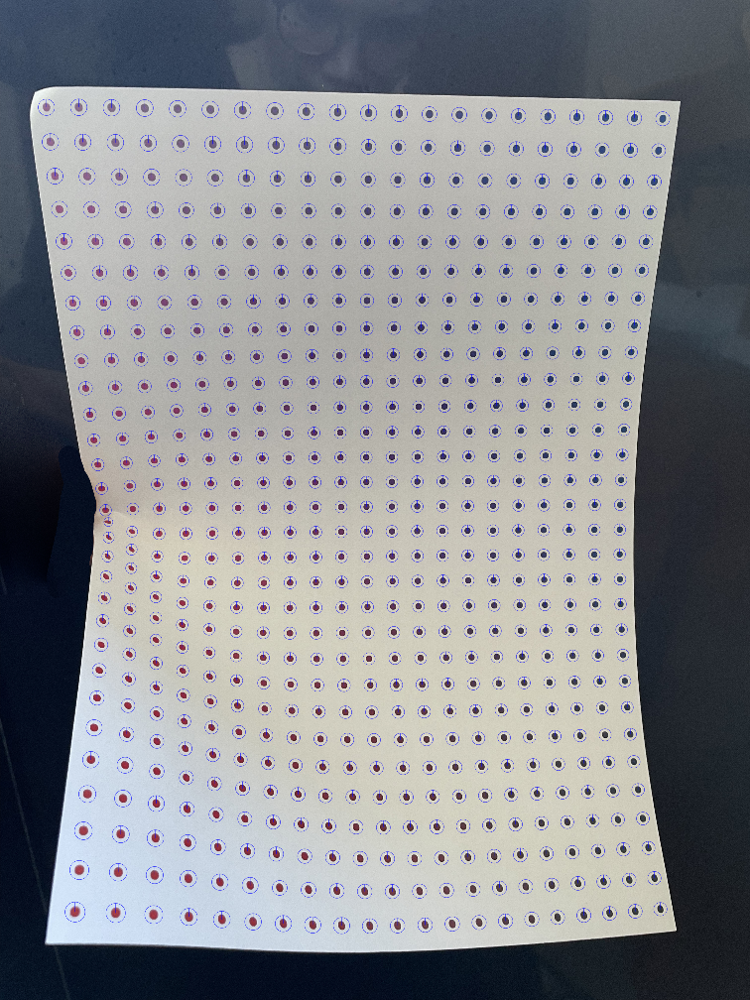

True

In [502]:
surf = cv.xfeatures2d.SURF_create(hessianThreshold=1500, upright=True)
kp, des = surf.detectAndCompute(img_blur, None)

new_kp, indices = delete_similar_key_points(kp, iou_threshold=0.2)
new_des = des[indices]

circle_kp_des = sorted(list(zip(new_kp, new_des)), key=lambda x: np.linalg.norm(x[1] - reference_circle_des))
circle_kp = [x[0] for x in circle_kp_des][:N_COLS * N_ROWS]
circle_des = [x[1] for x in circle_kp_des][:N_COLS * N_ROWS]

img_surf = cv.drawKeypoints(img, circle_kp, None, (255, 0, 0), 4)
cv2_imshow(reduce_in_size(img_surf, 4))

cv.imwrite(f'{RESULTS_FOLDER}/detected_{FILEBASENAME}.png', img_surf)

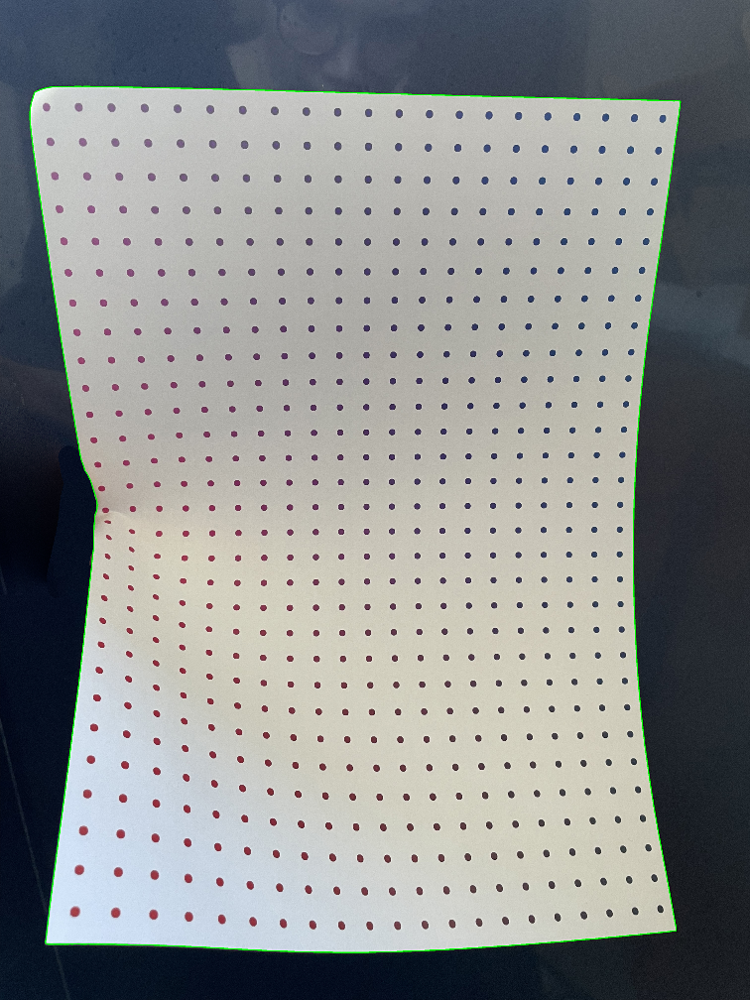

True

In [503]:
# thresh = cv.adaptiveThreshold(img_blur, 255, cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY, 77, -10)
thresh = cv.threshold(img_blur, 0, 255, cv.THRESH_BINARY+cv.THRESH_OTSU)[1]

kernel = np.ones((7,7), np.uint8)
morph = cv.morphologyEx(thresh, cv.MORPH_CLOSE, kernel)
morph = cv.morphologyEx(morph, cv.MORPH_OPEN, kernel)

contours = cv.findContours(morph, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
contours = contours[0] if len(contours) == 2 else contours[1]
big_contour = max(contours, key=cv.contourArea)

countour_img = img.copy()
countour_img = cv.drawContours(countour_img, [big_contour], 0, (0,255,0), 3)
cv2_imshow(reduce_in_size(countour_img, 4))

cv.imwrite(f'{RESULTS_FOLDER}/countour_{FILEBASENAME}.png', countour_img)

In [504]:
def get_corners_of_contour(contour, epsilon=0.04):
  """
  Return corners of rectangle-like contour.
  The order is: top-left, bottom-left, bottom-right, top-right
  """

  perimeter = cv.arcLength(contour, closed=True)
  corners = cv.approxPolyDP(contour, epsilon * perimeter, closed=True).squeeze()

  top_corner_index = np.argmin(corners[:, 1])
  corners = np.roll(corners, -top_corner_index, axis=0)

  if np.linalg.norm(corners[0] - corners[1]) < np.linalg.norm(corners[2] - corners[1]):
    corners = np.roll(corners, -1, axis=0)

  assert len(corners) == 4, f"Number of corners is {len(corners)} != 4"

  return corners

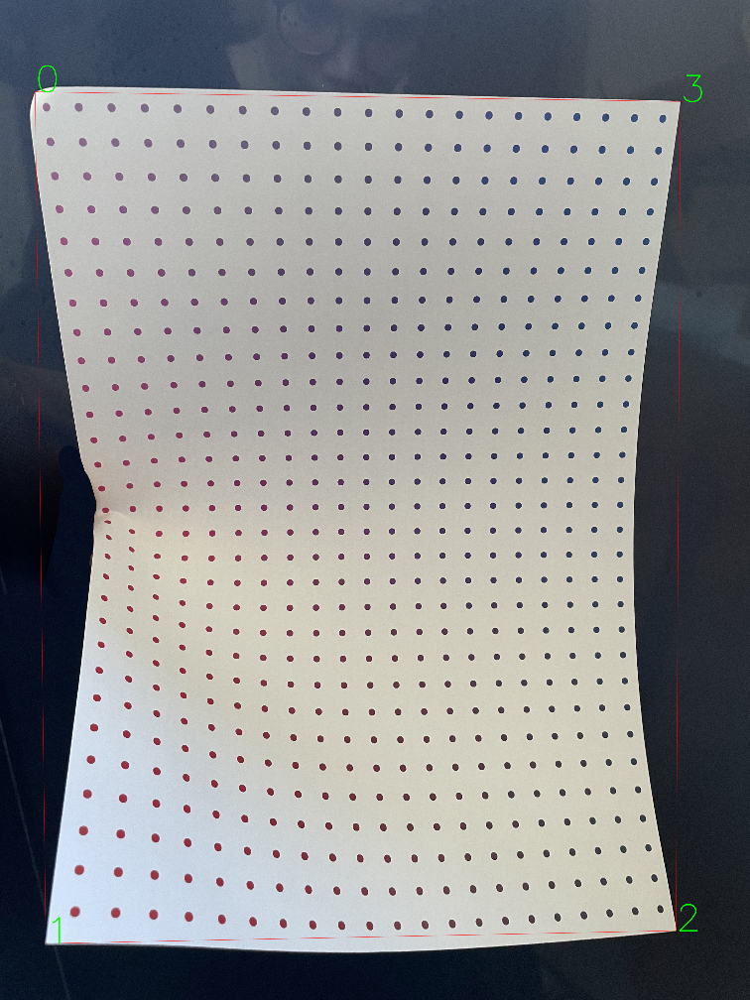

True

In [505]:
corners = get_corners_of_contour(big_contour)

polygon = img.copy()
cv.polylines(polygon, [corners], True, (0,0,255), 1, cv.LINE_AA)

for i in range(4):
  polygon = cv.putText(
      polygon, 
      str(i), 
      tuple(rint(corners[i])), 
      cv.FONT_HERSHEY_SIMPLEX, 
      5,
      (0, 255, 0), 
      3, 
      cv.LINE_AA)

cv2_imshow(reduce_in_size(polygon, 4))
cv.imwrite(f'{RESULTS_FOLDER}/polygon_{FILEBASENAME}.png', polygon)

## Alpha Shape

In [506]:
def get_frame_indices(top_left, h, w):
  """
  returns counter-clockwise frame indices starting from top-left index
  """
  x, y = top_left
  x_indices = np.concatenate((np.repeat(x, h - 1), 
                              np.arange(x, x + w - 1), 
                              np.repeat(x + w - 1, h - 1), 
                              np.arange(x + w - 1, x, -1)))
  

  y_indices = np.concatenate((np.arange(y, y + h - 1), 
                              np.repeat(y + h - 1, w - 1), 
                              np.arange(y + h - 1, y, -1), 
                              np.repeat(y, w - 1)))
  
  return x_indices, y_indices

/usr/local/lib/python3.7/dist-packages/descartes/patch.py:65: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  for t in polygon])


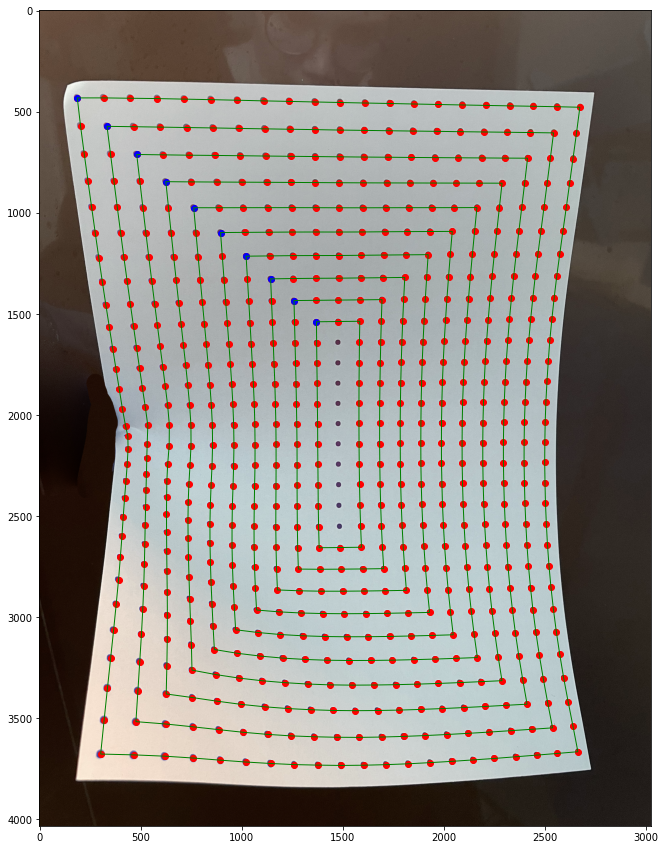

In [507]:
ordered_kp = np.full((N_ROWS, N_COLS, 2), fill_value=-1, dtype=float)

unvisited_points = set([x.pt for x in circle_kp])

frame_height = N_ROWS
frame_width = N_COLS

fig, ax = plt.subplots(figsize=(20, 15))

i = 0

while frame_height > 1 and frame_width > 1:
# while i < 5:
  points = list(unvisited_points)

  alpha = 0.005
  hull = alphashape.alphashape(points, alpha)
  hull_points = hull.exterior.coords.xy
  hull_points = np.stack(hull_points, axis=1)[:-1]


  top_left_index =  np.argmin(np.linalg.norm(hull_points - corners[0], axis=1))
  hull_points = np.roll(hull_points, -top_left_index, axis=0)


  ax.scatter(hull_points[:, 0], hull_points[:, 1], color='red')
  ax.scatter(hull_points[0, 0], hull_points[0, 1], color='blue')
  ax.add_patch(PolygonPatch(hull, fill=False, color='green'))
  ax.imshow(img)



  frame_indices_x, frame_indices_y = get_frame_indices([i, i], frame_height, frame_width)
  ordered_kp[frame_indices_y, frame_indices_x] = hull_points

  unvisited_points.difference_update(list(map(tuple, hull_points)))
  frame_height -= 2
  frame_width -= 2
  i += 1


plt.show()

In [508]:
center_points = np.array(sorted(
    list(map(np.array, list(unvisited_points))),
    key=lambda x: x[1])
    )

ordered_kp[i: i + frame_height, i] = center_points

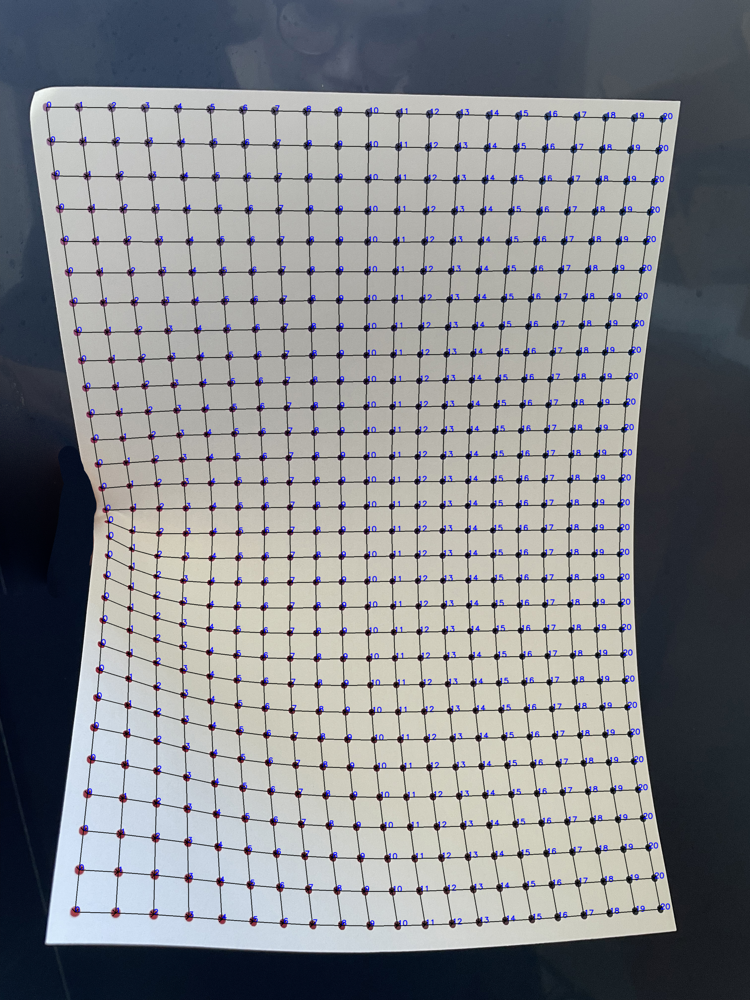

True

In [509]:
img_ordered_markers = img.copy()

for row in range(N_ROWS):
  for col in range(N_COLS):
      cv.putText(
        img_ordered_markers, 
        f'{col}',
        tuple(rint(ordered_kp[row][col])), 
        cv.FONT_HERSHEY_SIMPLEX, 
        1,
        (255, 0, 0), 
        2,
        cv.LINE_AA)
      
      if col < N_COLS - 1:
        img_ordered_markers = cv.arrowedLine(img_ordered_markers, 
                            tuple(rint(ordered_kp[row][col])), 
                            tuple(rint(ordered_kp[row][col + 1])),
                            (0, 0, 0), 2)
      if row < N_ROWS - 1:
        img_ordered_markers = cv.arrowedLine(img_ordered_markers, 
                            tuple(rint(ordered_kp[row][col])), 
                            tuple(rint(ordered_kp[row + 1][col])),
                            (0, 0, 0), 2)
      
cv2_imshow(reduce_in_size(img_ordered_markers, 2))
cv.imwrite(f'{RESULTS_FOLDER}/ordered_alpha_shape_{FILEBASENAME}.png', img_ordered_markers)

# Удаление маркеров 2

In [510]:
mask = np.zeros((img.shape[0], img.shape[1]), dtype=np.uint8)
for kp in circle_kp:
  mask = cv.circle(mask, rint(kp.pt), rint(kp.size / 2), (255, 255, 255), -1)

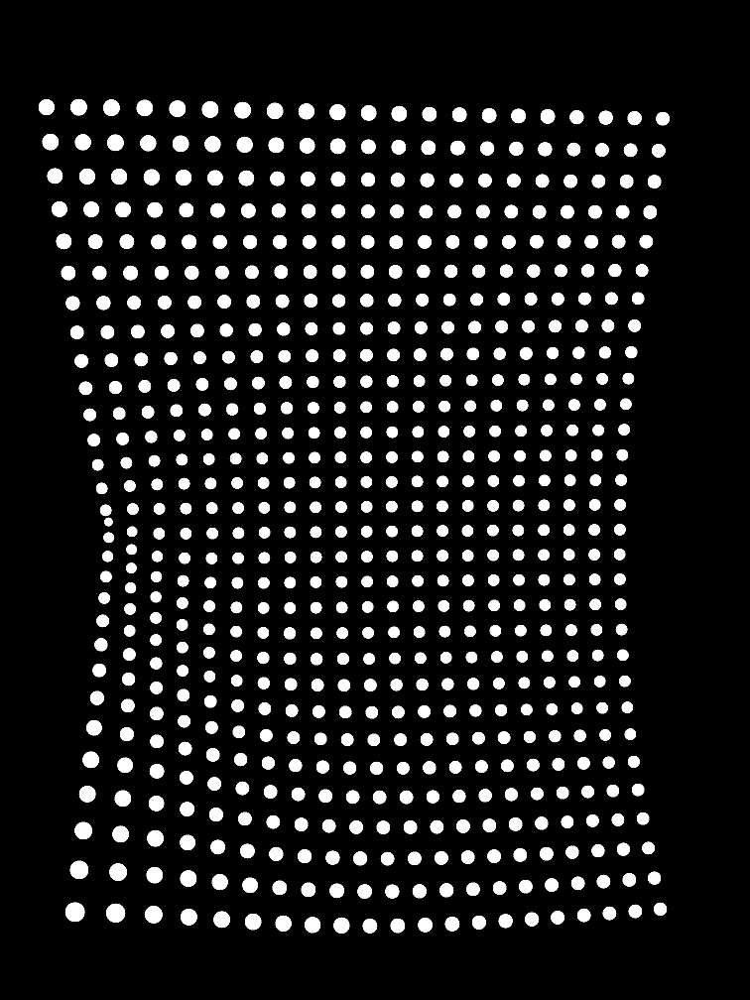

In [511]:
cv2_imshow(reduce_in_size(mask, 4))

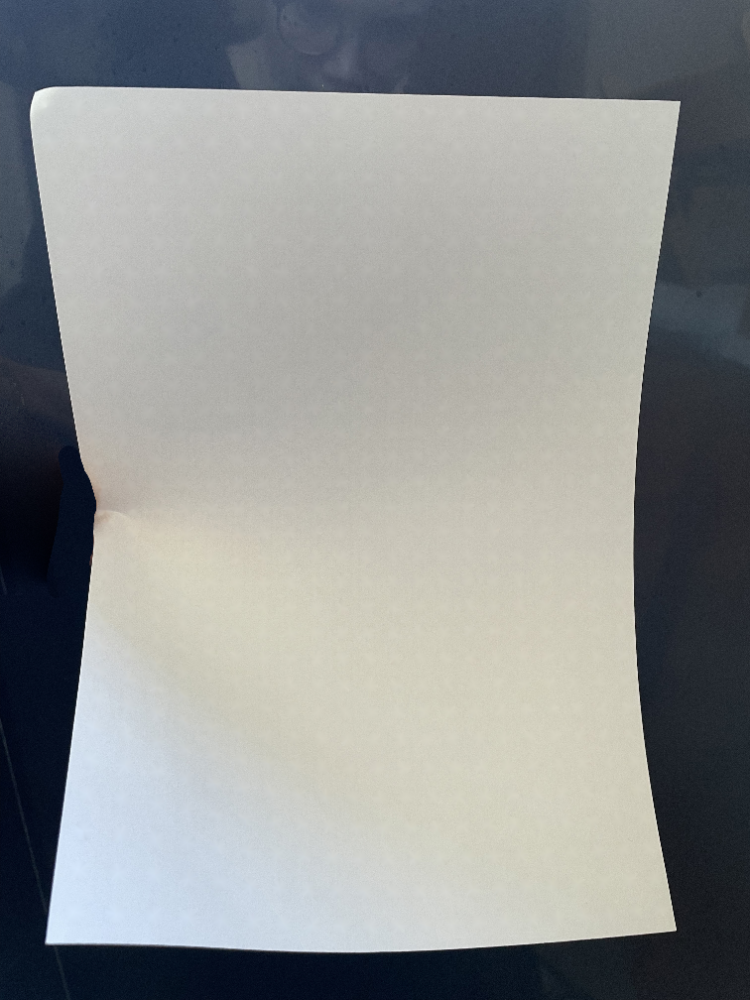

In [512]:
if f'inpainted_{FILEBASENAME}.png' in os.listdir(RESULTS_FOLDER):
  inpainted = cv.imread(f'{RESULTS_FOLDER}/inpainted_{FILEBASENAME}.png')
else:
  pass
  inpainted = cv.inpaint(img, mask, 3, cv.INPAINT_TELEA)
  cv.imwrite(f'{RESULTS_FOLDER}/inpainted_{FILEBASENAME}.png', inpainted)


cv2_imshow(reduce_in_size(inpainted, 4))

# Смятие документа 2

In [517]:
EDOCFILE = next(edocs_gen)
EDOCBASENAME = EDOCFILE.split('.')[0]

In [518]:
EDOCFILE

'Diagram description (1)_dpi_4000001-1.png'

In [519]:
edoc = cv.imread(path.join(SAMPLES_FOLDER, 'electronic_documents', EDOCFILE))

In [520]:
edoc_height, edoc_width = edoc.shape[:2]
photo_height, photo_width = img.shape[:2]

In [521]:
crumpled_grid = ordered_kp.copy()

crumpled_grid[:, :, 1] *= edoc_height / photo_height
crumpled_grid[:, :, 0] *= edoc_width / photo_width

In [522]:
y_grid = np.linspace(0, edoc_height, N_ROWS)
x_grid = np.linspace(0, edoc_width, N_COLS)

In [523]:
points = np.transpose(np.indices((edoc_width, edoc_height)), (2, 1, 0))

init_dot_positions = np.stack(np.meshgrid(x_grid, y_grid), axis=2).reshape((-1, 2))

transformed_dot_positions = crumpled_grid.reshape((-1, 2))

In [524]:
interpolated = interpolate.griddata(init_dot_positions, transformed_dot_positions, points, method='linear')
interpolated = rint(interpolated)

In [525]:
assert np.all(interpolated >= 0)
assert np.all(interpolated[:, :, 0] < edoc_width)
assert np.all(interpolated[:, :, 0] < edoc_height)

In [526]:
transformed_edoc = np.full((edoc_height, edoc_width, 3), 255, dtype=np.uint8)
transformed_edoc[interpolated[:, :, 1], interpolated[:, :, 0], :] = edoc

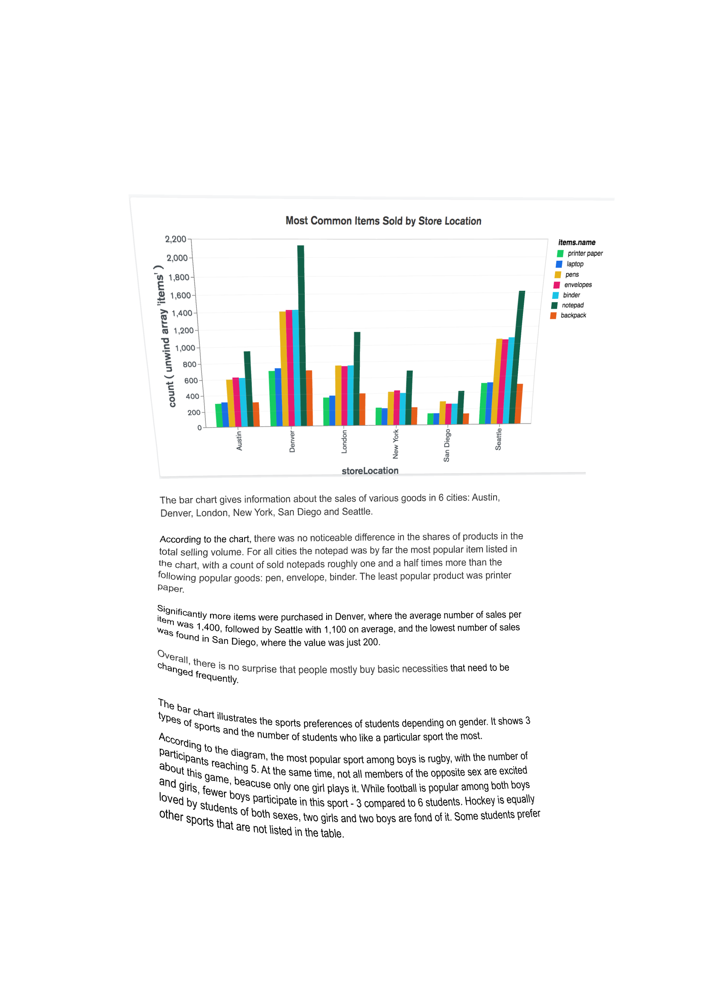

True

In [527]:
cv2_imshow(reduce_in_size(transformed_edoc, 2))
cv.imwrite(f'{RESULTS_FOLDER}/transformed_{FILEBASENAME}_{EDOCBASENAME}_dpi_{PDF_DPI}.png', transformed_edoc)

## Аугментации

## Используя часть преобразования

In [528]:
def get_rotation_matrix(angle):
  return np.array([[np.cos(angle), -np.sin(angle)],
                   [np.sin(angle), np.cos(angle)]])

In [532]:
decrease_rate = 0.6
rotation_angle = np.radians(20)

In [533]:
rotation_matrix = get_rotation_matrix(rotation_angle)

In [534]:
h = edoc_height * decrease_rate
w = edoc_width * decrease_rate

In [535]:
small_rectangle = np.array([[0, 0, w, w],
                            [h, 0, 0, h]])

small_rectangle[0] -= w / 2
small_rectangle[1] -= h / 2

In [536]:
small_rectangle_rotated = rotation_matrix @ small_rectangle

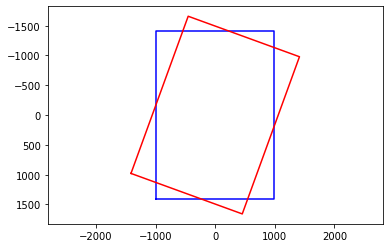

In [537]:
plt.plot(np.append(small_rectangle[0], small_rectangle[0][0]), 
         np.append(small_rectangle[1], small_rectangle[1][0]),
         color='blue')

plt.plot(np.append(small_rectangle_rotated[0], small_rectangle_rotated[0][0]), 
         np.append(small_rectangle_rotated[1], small_rectangle_rotated[1][0]),
         color='red')

plt.gca().invert_yaxis()
plt.axis('equal')
plt.show()

In [538]:
def ceil_even(number):
  ceil_even = int(np.ceil(number))
  if ceil_even % 2 != 0:
    ceil_even += 1
  return ceil_even

In [539]:
small_grid = np.rollaxis(init_dot_positions * decrease_rate, 1)
small_grid[0] -= w / 2
small_grid[1] -= h / 2
small_grid = np.dot(rotation_matrix, small_grid)

# plt.scatter(small_grid[0], small_grid[1])
# plt.axis('equal')
# plt.show()

In [540]:
rotated_w = ceil_even(small_grid[0].max() - small_grid[0].min())
rotated_h = ceil_even(small_grid[1].max() - small_grid[1].min())

In [541]:
x_center_range = np.arange(rotated_w / 2, edoc_width - rotated_w / 2, dtype=int)
y_center_range = np.arange(rotated_h / 2, edoc_height - rotated_h / 2, dtype=int)

In [542]:
assert len(x_center_range) > 0, 'bad parameters, rectangle does not fit the page'
assert len(y_center_range) > 0, 'bad parameters, rectangle does not fit the page'

In [543]:
center_x = np.random.choice(x_center_range)
center_y = np.random.choice(y_center_range)

rectangle_center = np.array([center_x, center_y])

In [544]:
small_grid += rectangle_center.reshape((-1, 1))

In [545]:
assert np.all(0 <= small_grid[0]) and np.all(small_grid[0] < edoc_width)
assert np.all(0 <= small_grid[1]) and np.all(small_grid[1] < edoc_height)

In [546]:
small_grid = rint(small_grid)

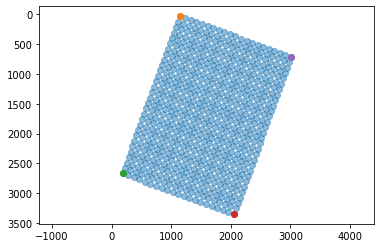

In [547]:
plt.scatter(small_grid[0], small_grid[1], alpha=.5)

corners = []

for i in [0, -N_COLS, -1, N_COLS - 1]:
  plt.scatter(small_grid[0][i], small_grid[1][i])
  corners.append([small_grid[0][i], small_grid[1][i]])

plt.gca().invert_yaxis()
plt.axis('equal')
plt.show()

In [548]:
corners = np.array(corners)



```
interpolated[i, j] = coordinates of edoc[i, j]
transformed_edoc[interpolated[i, j][1], interpolated[i, j][0]] = edoc[i, j]
```



In [549]:
transformed_small_grid = interpolated[small_grid[1], small_grid[0], :]

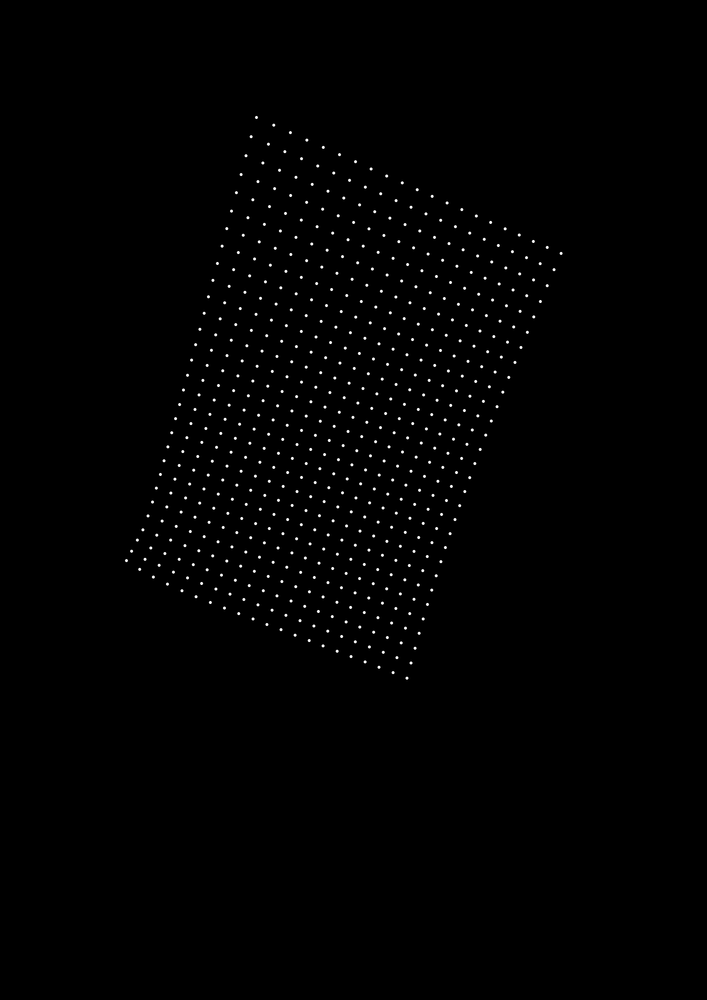

In [550]:
transformed_small_grid_img = np.zeros((edoc_height, edoc_width))
for center in transformed_small_grid:
  cv.circle(transformed_small_grid_img, tuple(center), 7, 255, -1)

cv2_imshow(transformed_small_grid_img)

In [551]:
x_min = transformed_small_grid[:, 0].min()
x_max = transformed_small_grid[:, 0].max()

y_min = transformed_small_grid[:, 1].min()
y_max = transformed_small_grid[:, 1].max()

In [552]:
w_0 = x_max - x_min
h_0 = y_max - y_min

In [570]:
width_margin = 0
height_margin = 0

In [571]:
zero_coord = np.array([x_min, y_min], dtype=int)
transformed_small_grid_aligned = transformed_small_grid - zero_coord
transformed_small_grid_aligned = transformed_small_grid_aligned.astype(float)

transformed_small_grid_aligned[:, 0] *= (edoc_width - 2 * width_margin) / w_0
transformed_small_grid_aligned[:, 1] *= (edoc_height - 2 * height_margin) / h_0

transformed_small_grid_aligned = rint(transformed_small_grid_aligned)

In [572]:
transformed_small_grid_aligned[:, 0] += width_margin
transformed_small_grid_aligned[:, 1] += height_margin

In [573]:
transformed_small_grid_aligned_img = np.zeros((edoc_height, edoc_width))
for center in transformed_small_grid_aligned:
  cv.circle(transformed_small_grid_aligned_img, tuple(center), 7, 255, -1)

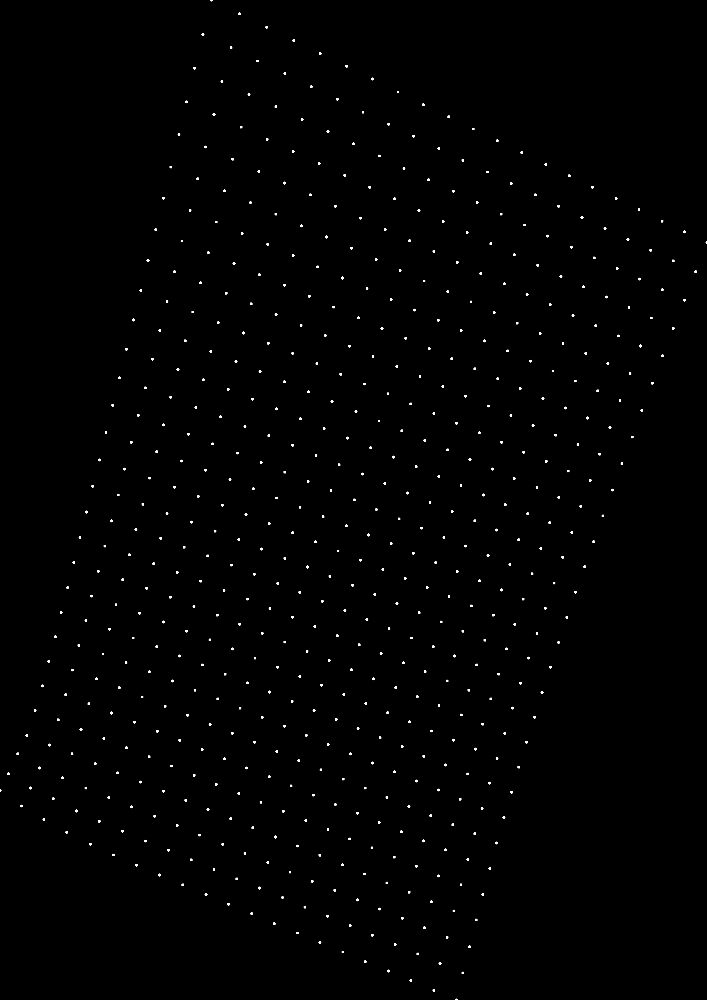

In [574]:
cv2_imshow(transformed_small_grid_aligned_img)

In [575]:
interpolated_aug = interpolate.griddata(init_dot_positions, transformed_small_grid_aligned, points, method='linear')
interpolated_aug = rint(interpolated_aug)

In [576]:
assert np.all(interpolated_aug >= 0)
assert np.all(interpolated_aug[:, :, 0] < edoc_width)
assert np.all(interpolated_aug[:, :, 0] < edoc_height)

In [592]:
transformed_edoc_aug = np.full((edoc_height, edoc_width, 3), 255, dtype=np.uint8)
transformed_edoc_aug[interpolated_aug[:, :, 1], interpolated_aug[:, :, 0], :] = edoc

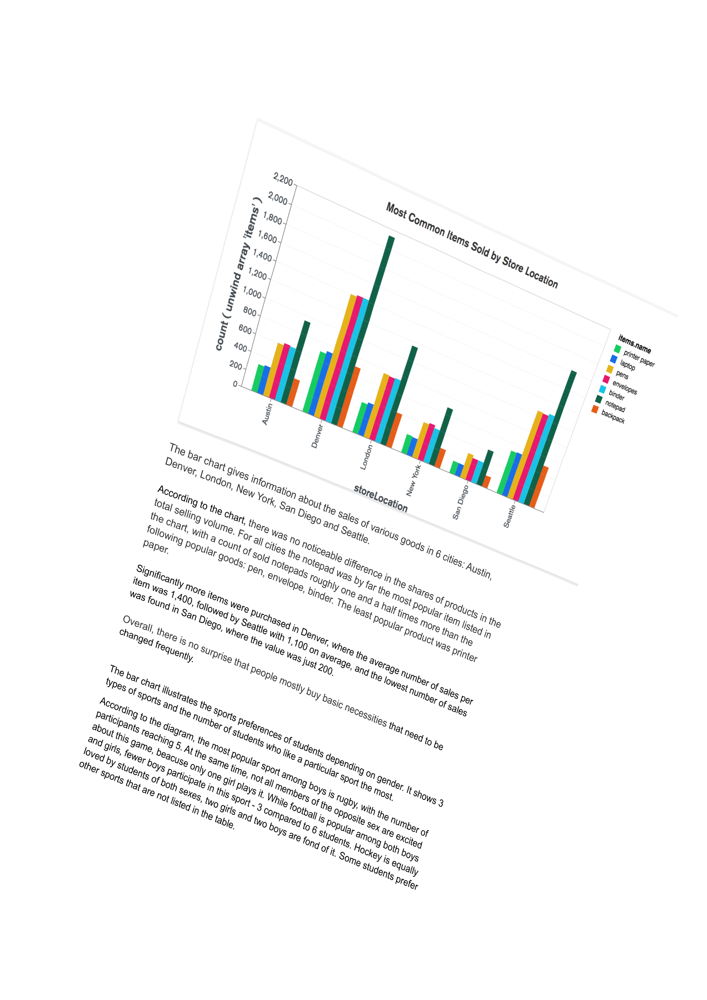

True

In [593]:
cv2_imshow(reduce_in_size(transformed_edoc_aug, 2))
cv.imwrite(f'{RESULTS_FOLDER}/transformed_augmentation_part_{FILEBASENAME}_{EDOCBASENAME}.png', transformed_edoc_aug)

### Освещение

In [579]:
check_rectangle_img = np.full((edoc_height, edoc_width), 0, dtype='uint8')
cv.drawContours(check_rectangle_img, [corners], 0, (255), 2)
rectangle_borders = np.argwhere(check_rectangle_img == 255)

In [580]:
# cv2_imshow(check_rectangle_img)

In [581]:
transformed_rectangle_borders = interpolated[rectangle_borders[:, 0], rectangle_borders[:, 1], :]

In [582]:
transformed_rectangle_borders_img = np.zeros((photo_height, photo_width, 3))

transformed_rectangle_borders_img = cv.drawContours(transformed_rectangle_borders_img, 
                [transformed_rectangle_borders],
                0, (1, 1, 1), -1)

# cv2_imshow(transformed_rectangle_borders_img * 255)

In [599]:
inpainted_part = inpainted * transformed_rectangle_borders_img
# cv2_imshow(inpainted_part)

In [600]:
inpainted_part.shape

(4032, 3024, 3)

In [601]:
x,y,w,h = cv.boundingRect(transformed_rectangle_borders)
# cv.rectangle(inpainted_part,(x, y),(x + w, y + h),(0,255,0),2)

# cv2_imshow(inpainted_part[y: y + h, x: x + w, :])

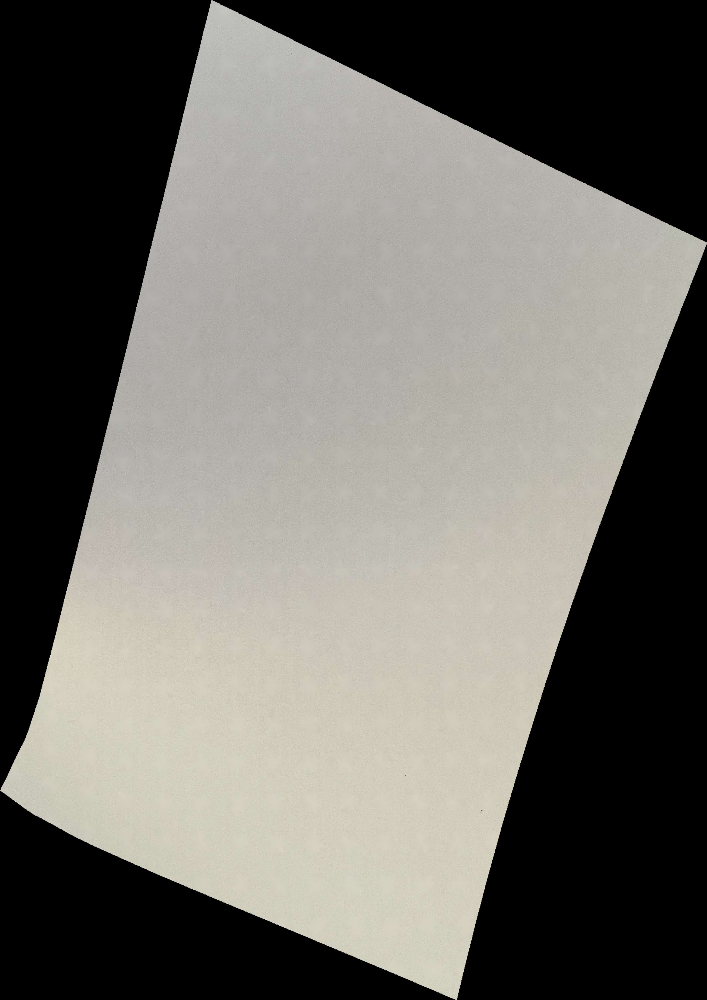

In [602]:
illumination_aug = cv.resize(inpainted_part[y: y + h, x: x + w, :], 
          (transformed_edoc_aug.shape[1], transformed_edoc_aug.shape[0]))

cv2_imshow(illumination_aug)

In [603]:
illumination_aug_normalized = cv.normalize(illumination_aug, None, alpha=0, beta=1, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)
transformed_edoc_aug_shadows_mult = illumination_aug_normalized * transformed_edoc_aug

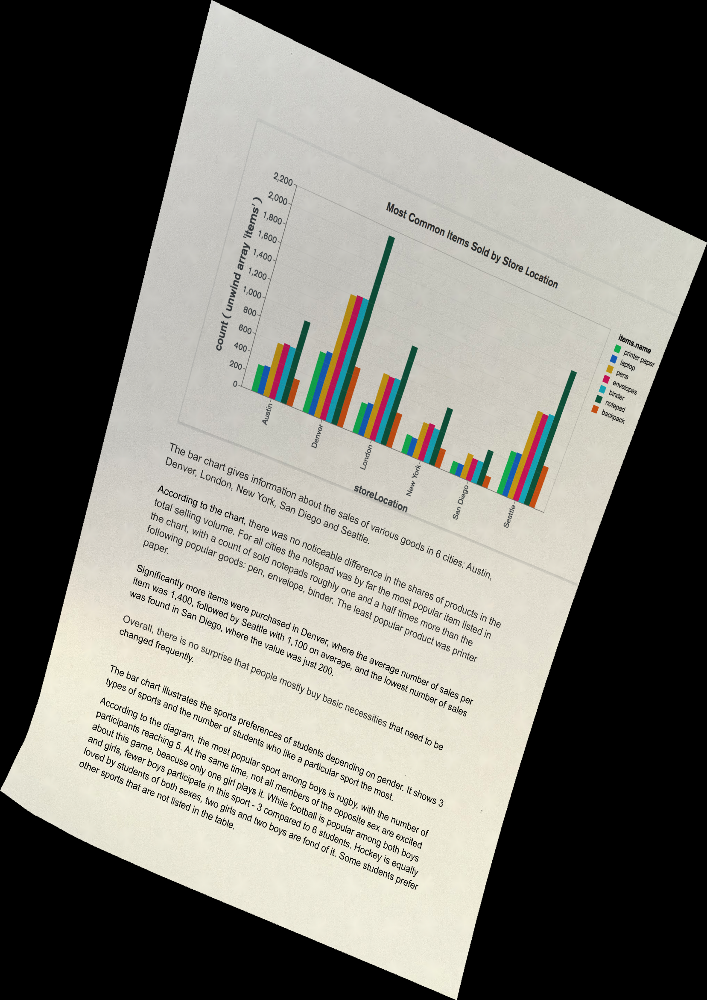

True

In [604]:
cv2_imshow(reduce_in_size(transformed_edoc_aug_shadows_mult, 2))

cv.imwrite(f'{RESULTS_FOLDER}/transformed_aug_shadows_mult_{FILEBASENAME}_{EDOCBASENAME}.png', transformed_edoc_aug_shadows_mult)
cv.imwrite(f'{CRUMPLED_RESULTS_FOLDER}/transformed_aug_shadows_mult_{FILEBASENAME}_{EDOCBASENAME}.png', transformed_edoc_aug_shadows_mult)

# Наложение освещения

In [ ]:
paper_contour = np.zeros(inpainted.shape)
paper_contour = cv.drawContours(paper_contour, [big_contour], 0, (1, 1, 1), -1)

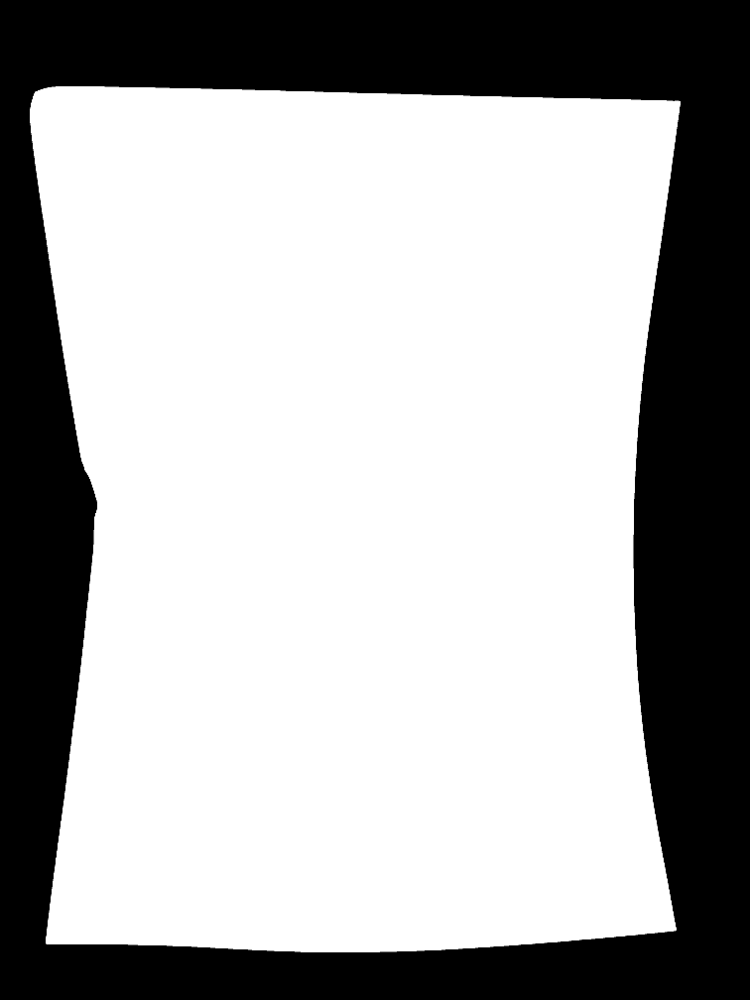

In [ ]:
cv2_imshow(reduce_in_size(paper_contour * 255, 4))

In [ ]:
illumination = inpainted * paper_contour
illumination = cv.resize(illumination, (edoc_width, edoc_height))

In [ ]:
illumination_normalized = cv.normalize(illumination, None, alpha=0, beta=1, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)
transformed_edoc_shadows_mult = illumination_normalized * transformed_edoc

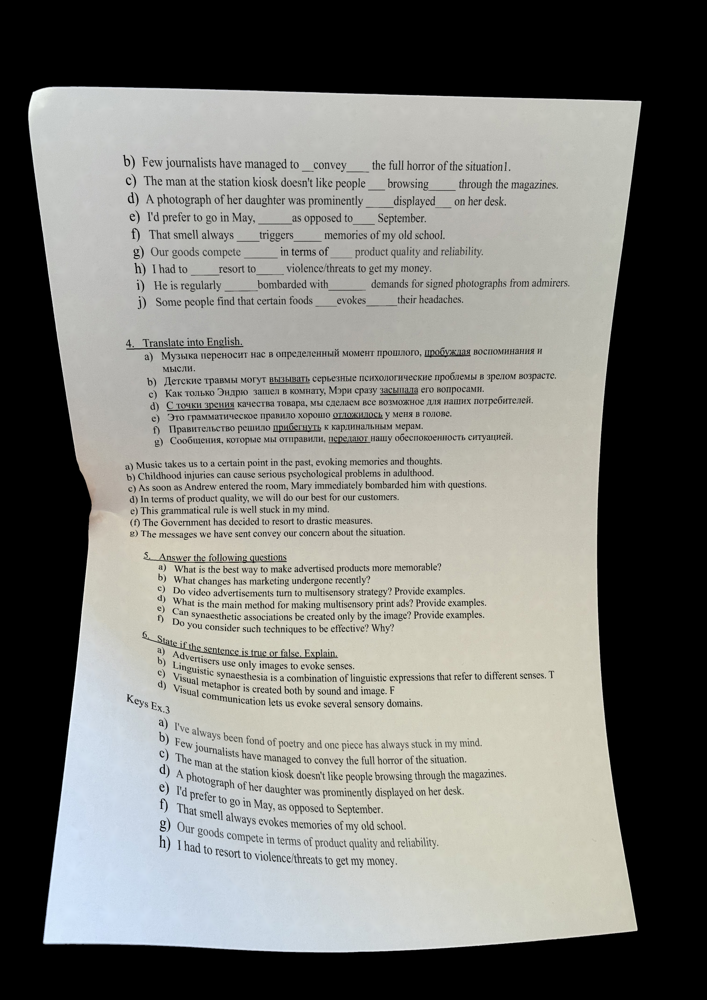

True

In [ ]:
cv2_imshow(reduce_in_size(transformed_edoc_shadows_mult, 2))
cv.imwrite(f'{RESULTS_FOLDER}/transformed_shadows_mult_{FILEBASENAME}_{EDOCBASENAME}.png', transformed_edoc_shadows_mult)
cv.imwrite(f'{CRUMPLED_RESULTS_FOLDER}/transformed_shadows_mult_{FILEBASENAME}_{EDOCBASENAME}.png', transformed_edoc_shadows_mult)

# Фон

In [ ]:
BACKGROUND_NAME = next(backgrounds_gen)
BACKGROUND_BASENAME = EDOCFILE.split('.')[0]

In [ ]:
background = cv.imread(path.join(BACKGROUND_FOLDER, BACKGROUND_NAME))

In [ ]:
background_height, background_width = background.shape[:2]

In [ ]:
output_height = np.min((photo_height, edoc_height, background_height))
output_width = np.min((photo_width, edoc_width, background_width))

In [ ]:
paper_contour = cv.resize(paper_contour, (output_width, output_height))
background = cv.resize(background, (output_width, output_height))
transformed_edoc_shadows_mult = cv.resize(transformed_edoc_shadows_mult, (output_width, output_height))

In [ ]:
transformed_edoc_shadows_mult_with_background = background * np.logical_not(paper_contour) \
                                                + transformed_edoc_shadows_mult * paper_contour

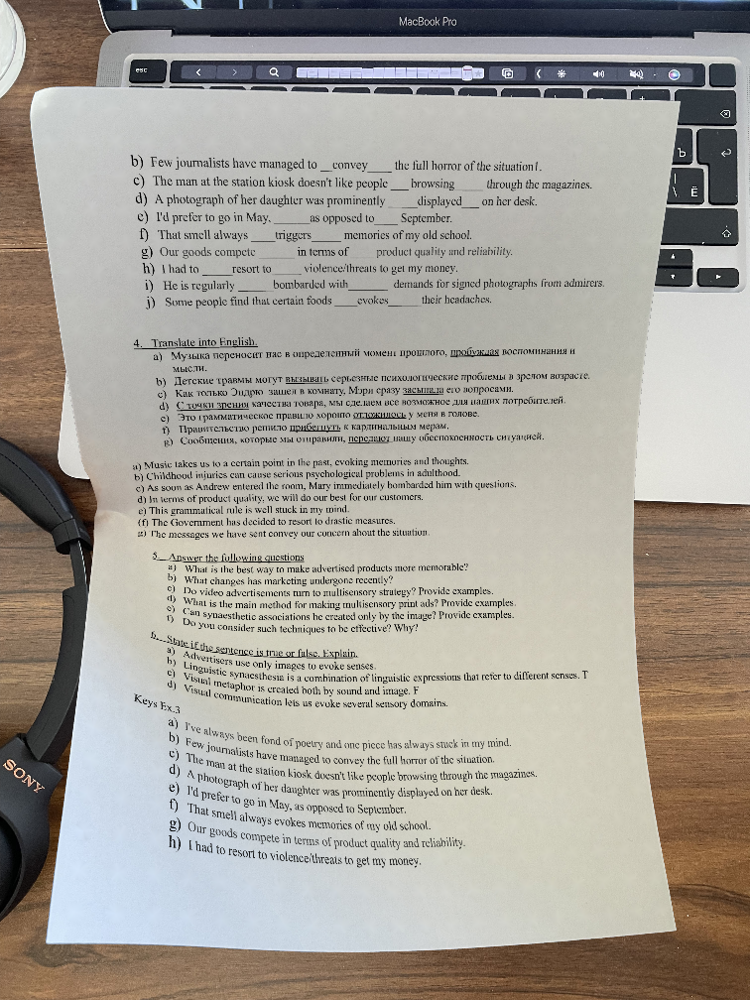

True

In [ ]:
cv2_imshow(reduce_in_size(transformed_edoc_shadows_mult_with_background, 4))

cv.imwrite(f'{RESULTS_FOLDER}/transformed_shadows_mult_with_background_{FILEBASENAME}_{EDOCBASENAME}.png', transformed_edoc_shadows_mult_with_background)
cv.imwrite(f'{CRUMPLED_RESULTS_FOLDER}/transformed_shadows_mult_with_background_{FILEBASENAME}_{EDOCBASENAME}.png', transformed_edoc_shadows_mult_with_background)

# Прогон изображений

In [ ]:
crumpled_photos = [
'IMG_3267.png', 
'IMG_1443.png', 
'IMG_1446.png', 
'IMG_1446.png', 
'IMG_3264.png', 
'IMG_3266.png', 
'IMG_1443.png', 
]

edoc_filenames = os.listdir(EDOCS_FOLDER)
random.shuffle(edoc_filenames)

# crumpled_photos_gen = (x for x in crumpled_photos)
crumpled_photos_gen = itertools.cycle(crumpled_photos)
edocs_gen = itertools.cycle(edoc_filenames)

In [ ]:
for my_dummy_index in tqdm(range(len(crumpled_photos))):
  FILENAME = next(crumpled_photos_gen)
  FILEBASENAME = FILENAME.split('.')[0]

  img = cv.imread(path.join(SAMPLES_FOLDER, FILENAME))

  if img.shape[0] < img.shape[1]:
    img = cv.rotate(img, cv.cv2.ROTATE_90_CLOCKWISE)
    cv.imwrite(path.join(SAMPLES_FOLDER, FILENAME), img)

  img_gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
  img_blur = cv.GaussianBlur(img_gray, (15, 15), 0)
  surf = cv.xfeatures2d.SURF_create(hessianThreshold=1500, upright=True)
  kp, des = surf.detectAndCompute(img_blur, None)

  new_kp, indices = delete_similar_key_points(kp, iou_threshold=0.2)
  new_des = des[indices]

  circle_kp_des = sorted(list(zip(new_kp, new_des)), key=lambda x: np.linalg.norm(x[1] - reference_circle_des))
  circle_kp = [x[0] for x in circle_kp_des][:N_COLS * N_ROWS]
  circle_des = [x[1] for x in circle_kp_des][:N_COLS * N_ROWS]

  img_surf = cv.drawKeypoints(img, circle_kp, None, (255, 0, 0), 4)

  cv.imwrite(f'{RESULTS_FOLDER}/detected_{FILEBASENAME}.png', img_surf)
  # thresh = cv.adaptiveThreshold(img_blur, 255, cv.ADAPTIVE_THRESH_GAUSSIAN_C, cv.THRESH_BINARY, 77, -10)
  thresh = cv.threshold(img_blur, 0, 255, cv.THRESH_BINARY+cv.THRESH_OTSU)[1]

  kernel = np.ones((7,7), np.uint8)
  morph = cv.morphologyEx(thresh, cv.MORPH_CLOSE, kernel)
  morph = cv.morphologyEx(morph, cv.MORPH_OPEN, kernel)

  contours = cv.findContours(morph, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
  contours = contours[0] if len(contours) == 2 else contours[1]
  big_contour = max(contours, key=cv.contourArea)

  countour_img = img.copy()
  countour_img = cv.drawContours(countour_img, [big_contour], 0, (0,255,0), 3)

  cv.imwrite(f'{RESULTS_FOLDER}/countour_{FILEBASENAME}.png', countour_img)
  # get perimeter and approximate a polygon
  peri = cv.arcLength(big_contour, True)
  corners = cv.approxPolyDP(big_contour, 0.04 * peri, True)

  # draw polygon on input image from detected corners
  polygon = img.copy()
  cv.polylines(polygon, [corners], True, (0,0,255), 1, cv.LINE_AA)
  # Alternate: cv.drawContours(page,[corners],0,(0,0,255),1)

  corners = corners.squeeze()

  # They seem to be listed counter-clockwise from the top most corner
  # renumerate so that the left top is the first
  if np.linalg.norm(corners[0] - corners[1]) < np.linalg.norm(corners[2] - corners[1]):
    corners = np.roll(corners, -1, axis=0)

  assert len(corners) == 4

  for i in range(4):
    polygon = cv.putText(
        polygon, 
        str(i), 
        tuple(rint(corners[i])), 
        cv.FONT_HERSHEY_SIMPLEX, 
        5,
        (0, 255, 0), 
        3, 
        cv.LINE_AA)

  cv.imwrite(f'{RESULTS_FOLDER}/polygon_{FILEBASENAME}.png', polygon)
  top_left_point = min(circle_kp, 
                      key=lambda x: 
                      np.linalg.norm(np.array(x.pt) - corners[0]))

  ordered_kp = np.empty((N_ROWS, N_COLS), dtype=cv.KeyPoint)
  ordered_kp[0][0] = top_left_point
  unvisited_kp = set(circle_kp)
  unvisited_kp.remove(top_left_point)


  img_ordered_markers = img.copy()


  for row in range(N_ROWS):
    for col in range(N_COLS - 1):
      current_point = ordered_kp[row][col]

      if row == N_ROWS - 1:
        consider_n_neighbours = 1
      elif col == 0 or col == 1:
        consider_n_neighbours = 3
      else:
        consider_n_neighbours = 4

      neighbours = sorted(unvisited_kp,
                    key=lambda x: 
                    np.linalg.norm(
                        np.array(x.pt) - np.array(current_point.pt))
                    )[:consider_n_neighbours]

      if col == 0 and row < N_ROWS - 1:
        ordered_kp[row + 1][0] = min(neighbours, 
                                      key=lambda x: (x.pt[0], -x.pt[1]))
        unvisited_kp.remove(ordered_kp[row + 1][0])

        img_ordered_markers = cv.arrowedLine(img_ordered_markers, 
                            rint(current_point.pt), 
                            rint(ordered_kp[row + 1][0].pt),
                            (0, 0, 0), 2)
        
      
      ordered_kp[row][col + 1] = min(neighbours, 
                                  key=lambda x: (x.pt[1], -x.pt[0]))
      unvisited_kp.remove(ordered_kp[row][col + 1])

      img_ordered_markers = cv.arrowedLine(img_ordered_markers, 
                            rint(current_point.pt), 
                            rint(ordered_kp[row][col + 1].pt),
                            (0, 0, 0), 2)

  for row in range(N_ROWS):
    for col in range(N_COLS):
        cv.putText(
          img_ordered_markers, 
          f'{col}',
          rint(ordered_kp[row][col].pt), 
          cv.FONT_HERSHEY_SIMPLEX, 
          1,
          (255, 0, 0), 
          2,
          cv.LINE_AA)
  cv.imwrite(f'{RESULTS_FOLDER}/ordered_{FILEBASENAME}.png', img_ordered_markers)

  mask = np.zeros((img.shape[0], img.shape[1]), dtype=np.uint8)
  for kp in circle_kp:
    mask = cv.circle(mask, rint(kp.pt), rint(kp.size / 2), (255, 255, 255), -1)
  inpainted = cv.inpaint(img, mask, 3, cv.INPAINT_TELEA)

  cv.imwrite(f'{RESULTS_FOLDER}/inpainted_{FILEBASENAME}.png', inpainted)


  for num_file_to_crumple in tqdm(range(3)):

    EDOCFILE = next(edocs_gen)
    EDOCBASENAME = EDOCFILE.split('.')[0]
    edoc = cv.imread(path.join(SAMPLES_FOLDER, 'electronic_documents', EDOCFILE))
    edoc_height, edoc_width = edoc.shape[:2]
    photo_height, photo_width = img.shape[:2]
    crumpled_grid = np.array(list(map(
        lambda point_list: 
        np.array([point.pt for point in point_list]), 
        ordered_kp)))

    crumpled_grid[:, :, 1] *= edoc_height / photo_height
    crumpled_grid[:, :, 0] *= edoc_width / photo_width
    y_grid = np.linspace(0, edoc_height, N_ROWS)
    x_grid = np.linspace(0, edoc_width, N_COLS)
    points = np.stack(np.meshgrid(range(edoc_width), range(edoc_height)), axis=2)

    init_dot_positions = np.stack(np.meshgrid(x_grid, y_grid), axis=2).reshape((-1, 2))

    transformed_dot_positions = crumpled_grid.reshape((-1, 2))
    interpolated = interpolate.griddata(init_dot_positions, transformed_dot_positions, points, method='linear')
    interpolated = rint(interpolated)
    assert np.all(interpolated >= 0)
    assert np.all(interpolated[:, :, 0] < edoc_width)
    assert np.all(interpolated[:, :, 0] < edoc_height)
    transformed_edoc = np.full((edoc_height, edoc_width, 3), 255, dtype=np.uint8)
    transformed_edoc[interpolated[:, :, 1], interpolated[:, :, 0], :] = edoc
    cv.imwrite(f'{RESULTS_FOLDER}/transformed_{FILEBASENAME}_{EDOCBASENAME}_dpi_{PDF_DPI}.png', transformed_edoc)
    paper_contour = np.zeros(inpainted.shape)
    paper_contour = cv.drawContours(paper_contour, [big_contour], 0, (1, 1, 1), -1)
    illumination = inpainted * paper_contour
    illumination = cv.resize(illumination, (edoc_width, edoc_height))
    illumination_normalized = cv.normalize(illumination, None, alpha=0, beta=1, norm_type=cv.NORM_MINMAX, dtype=cv.CV_32F)
    transformed_edoc_shadows_mult = illumination_normalized * transformed_edoc
    cv.imwrite(f'{RESULTS_FOLDER}/transformed_shadows_mult_{FILEBASENAME}_{EDOCBASENAME}.png', transformed_edoc_shadows_mult)
    cv.imwrite(f'{CRUMPLED_RESULTS_FOLDER}/transformed_shadows_mult_{FILEBASENAME}_{EDOCBASENAME}.png', transformed_edoc_shadows_mult)

100%|██████████| 7/7 [14:30<00:00, 124.32s/it]
